# $\Phi$-SO Pos

## Packages import

In [1]:
# External packages
import torch
import numpy as np
import pandas as pd

# Pyplot
import matplotlib.pyplot as plt

# Internal code import
import physo
from physo.learn import monitoring
from physo.task  import benchmark

In [2]:
# Device
DEVICE = 'cpu'
if torch.cuda.is_available():
    DEVICE = 'cuda'
print(DEVICE)

cpu


In [3]:
torch.cuda.is_available()

False

## Test case

#### Data points

In [4]:
data_size = int(96)

In [5]:
ocp_pos = pd.read_parquet("/Users/bradyplanden/Documents/Git/2023-oslo-workshop/lnmo-exercise/LNMO_theta_OCV_singleSweep.parquet")

#### Sending data to device

In [6]:
# ------ Vectors ------
# Stack of all input variables
X = torch.tensor(np.stack((np.array(ocp_pos.theta),), axis=0)).to(DEVICE)
# Output of symbolic function to guess
y = torch.tensor(np.array(ocp_pos.OCV)).to(DEVICE)

# ------ Constants ------
const1 = torch.tensor(np.array( 1.   )).to(DEVICE)

## Run config

### Library config

In [7]:
# [length, mass, time]
args_make_tokens = {
                # operations
                "op_names"             : ["mul", "add", "sub", "div", "inv", "n2", "sqrt", "neg", "exp", "log", "sin", "cos"],
                "use_protected_ops"    : True,
                # input variables
                "input_var_ids"        : {"t" : 0         ,},
                "input_var_units"      : {"t" : [0, 0, 1] ,},
                "input_var_complexity" : {"t" : 1.        ,},
                # constants
                "constants"            : {"1" : const1    , },
                "constants_units"      : {"1" : [0, 0, 0] , },
                "constants_complexity" : {"1" : 1.        , },
                # free constants
                "free_constants"            : {"f"               , "alpha0"               , "phi"               , },
                "free_constants_init_val"   : {"f" : 1.          , "alpha0" : 1/10.       , "phi" : 1.          , },
                "free_constants_units"      : {"f" : [0, 0, -1]  , "alpha0" : [0, 0, -1]  , "phi" : [0, 0, 0]   , },
                "free_constants_complexity" : {"f" : 1.          , "alpha0" : 1.          , "phi" : 1.          , },
                    }

library_config = {"args_make_tokens"  : args_make_tokens,
                  "superparent_units" : [0, 0, 0],
                  "superparent_name"  : "F",
                }


### Learning config

In [8]:
reward_config = {
                 "reward_function"     : physo.physym.reward.SquashedNRMSE, 
                 "zero_out_unphysical" : True,
                 "zero_out_duplicates" : False,
                 "keep_lowest_complexity_duplicate" : False,
                }

In [9]:
BATCH_SIZE = int(96)
MAX_LENGTH = 30
GET_OPTIMIZER = lambda model : torch.optim.Adam(
                                    model.parameters(),                
                                    lr=0.0025, #0.001, #0.0050, #0.0005, #1,  #lr=0.0025
                                                )

In [23]:
learning_config = {
    # Batch related
    'batch_size'       : BATCH_SIZE,
    'max_time_step'    : MAX_LENGTH,
    'n_epochs'         : int(1e3),
    # Loss related
    'gamma_decay'      : 0.7,
    'entropy_weight'   : 0.005,
    # Reward related
    'risk_factor'      : 0.05,
    'rewards_computer' : physo.physym.reward.make_RewardsComputer (**reward_config),
    # Optimizer
    'get_optimizer'    : GET_OPTIMIZER,
    'observe_units'    : True,
}

### Free constant optimizer config

In [11]:
free_const_opti_args = {
            'loss'   : "MSE",
            'method' : 'LBFGS',
            'method_args': {
                        'n_steps' : 15,
                        'tol'     : 1e-6,
                        'lbfgs_func_args' : {
                            'max_iter'       : 4,
                            'line_search_fn' : "strong_wolfe",
                                             },
                            },
        }

### Priors config

In [12]:
priors_config  = [
                #("UniformArityPrior", None),
                # LENGTH RELATED
                ("HardLengthPrior"  , {"min_length": 4, "max_length": MAX_LENGTH, }),
                ("SoftLengthPrior"  , {"length_loc": 8, "scale": 5, }),
                # RELATIONSHIPS RELATED
                ("NoUselessInversePrior"  , None),
                ("PhysicalUnitsPrior", {"prob_eps": np.finfo(np.float32).eps}), # PHYSICALITY
                ("NestedFunctions", {"functions":["exp",], "max_nesting" : 1}),
                ("NestedFunctions", {"functions":["log",], "max_nesting" : 1}),
                ("NestedTrigonometryPrior", {"max_nesting" : 1}),           
                #("OccurrencesPrior", {"targets" : ["1",], "max" : [3,] }),
                 ]

### Cell config

In [13]:
cell_config = {
    "hidden_size" : 128,
    "n_layers"    : 1,
    "is_lobotomized" : False,
}

### Logger

In [14]:
save_path_training_curves = 'harmonic_curves.png'
save_path_log             = 'harmonic.log'

run_logger     = monitoring.RunLogger(save_path = save_path_log, 
                                      do_save = True)

run_visualiser = monitoring.RunVisualiser (epoch_refresh_rate = 1,
                                           save_path = save_path_training_curves,
                                           do_show   = False,
                                           do_prints = True,
                                           do_save   = True, )

### Run config

In [24]:
run_config = {
    "learning_config"      : learning_config,
    "reward_config"        : reward_config,
    "free_const_opti_args" : free_const_opti_args,
    "library_config"       : library_config,
    "priors_config"        : priors_config,
    "cell_config"          : cell_config,
    "run_logger"           : run_logger,
    "run_visualiser"       : run_visualiser,
}

## Dummy epoch for prior tuning

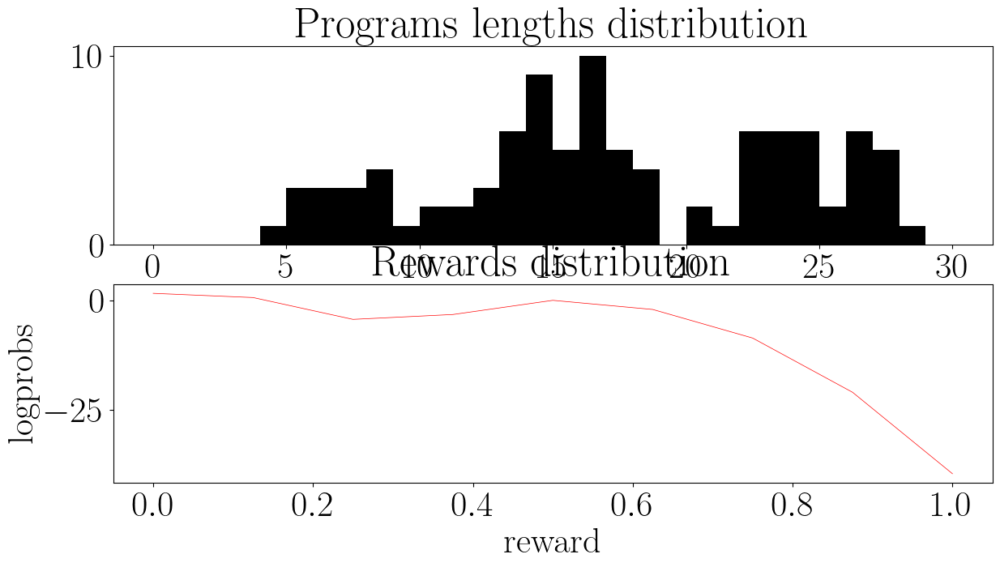

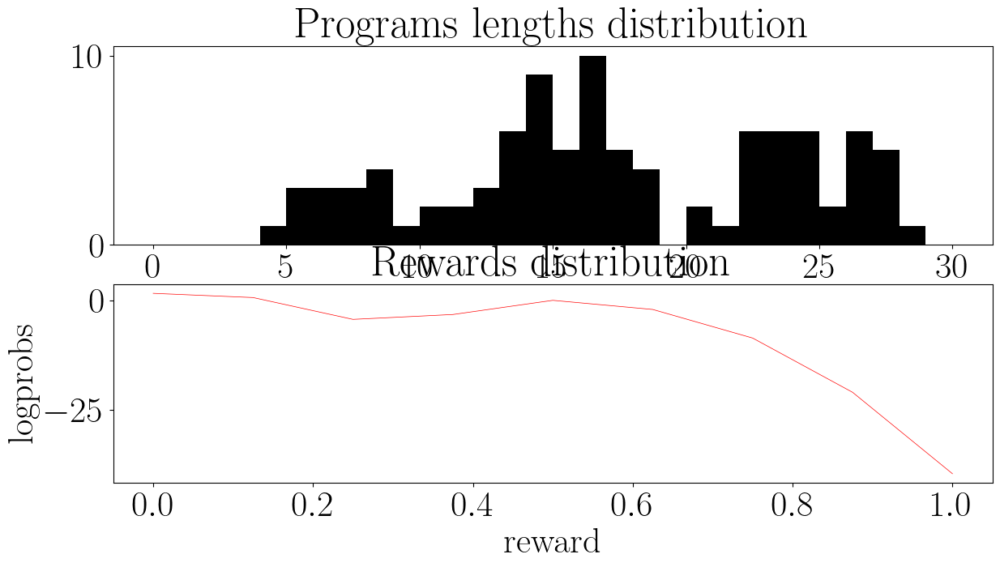

In [25]:
benchmark.dummy_epoch(X, y, run_config)

## Run

Unable to make visualisation plots.
Unable to save train curves data.
=========== Epoch 00000 ===========
-> Time 5.09 s

Overall best  at R=0.696975
-> Raw expression : 
                 1                  
────────────────────────────────────
⎛                         0.5    ⎞  
⎜⎛        ⎛     α₀      ⎞⎞       ⎟  
⎜⎜-φ + log⎜- ─────── - φ⎟⎟    - 1⎟⋅1
⎜⎜        ⎜      φ⋅φ    ⎟⎟       ⎟  
⎜⎜        ⎜  f + ───    ⎟⎟       ⎟  
⎝⎝        ⎝       t     ⎠⎠       ⎠  

Best of epoch at R=0.696975
-> Raw expression : 
                 1                  
────────────────────────────────────
⎛                         0.5    ⎞  
⎜⎛        ⎛     α₀      ⎞⎞       ⎟  
⎜⎜-φ + log⎜- ─────── - φ⎟⎟    - 1⎟⋅1
⎜⎜        ⎜      φ⋅φ    ⎟⎟       ⎟  
⎜⎜        ⎜  f + ───    ⎟⎟       ⎟  
⎝⎝        ⎝       t     ⎠⎠       ⎠  


Unable to make visualisation plots.
Unable to save train curves data.
=========== Epoch 00001 ===========
-> Time 5.29 s

Overall best  at R=0.696975
-> Raw expression : 
              

/Users/bradyplanden/Documents/Git/PhySO/physo/learn/monitoring.py:595: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=figsize)


=========== Epoch 00019 ===========
-> Time 5.62 s

Overall best  at R=0.696975
-> Raw expression : 
                 1                  
────────────────────────────────────
⎛                         0.5    ⎞  
⎜⎛        ⎛     α₀      ⎞⎞       ⎟  
⎜⎜-φ + log⎜- ─────── - φ⎟⎟    - 1⎟⋅1
⎜⎜        ⎜      φ⋅φ    ⎟⎟       ⎟  
⎜⎜        ⎜  f + ───    ⎟⎟       ⎟  
⎝⎝        ⎝       t     ⎠⎠       ⎠  

Best of epoch at R=0.597284
-> Raw expression : 
    ⎛               1          ⎞        
f⋅t⋅⎜-φ + ─────────────────────⎟ - φ - 1
    ⎝     log(-α₀⋅(-t + t + t))⎠        


Unable to make visualisation plots.
Unable to save train curves data.
=========== Epoch 00020 ===========
-> Time 4.68 s

Overall best  at R=0.696975
-> Raw expression : 
                 1                  
────────────────────────────────────
⎛                         0.5    ⎞  
⎜⎛        ⎛     α₀      ⎞⎞       ⎟  
⎜⎜-φ + log⎜- ─────── - φ⎟⎟    - 1⎟⋅1
⎜⎜        ⎜      φ⋅φ    ⎟⎟       ⎟  
⎜⎜        ⎜  f + ───    ⎟⎟       ⎟ 

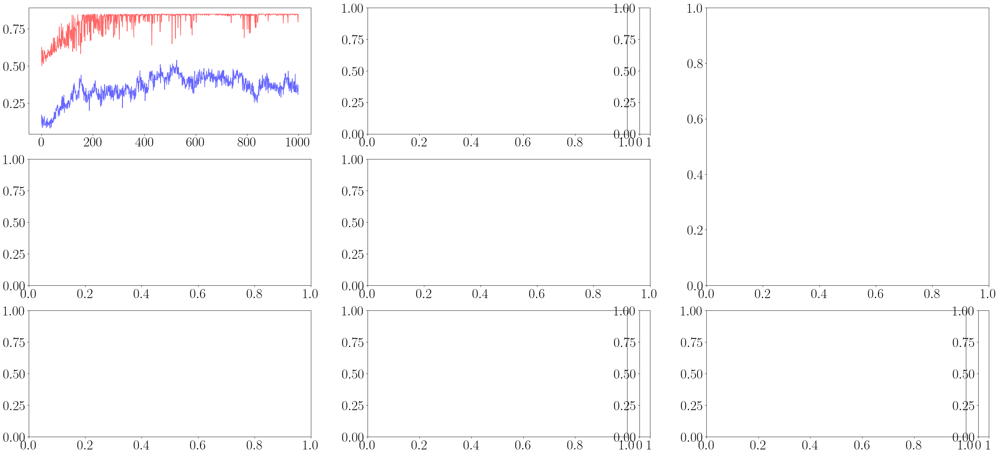

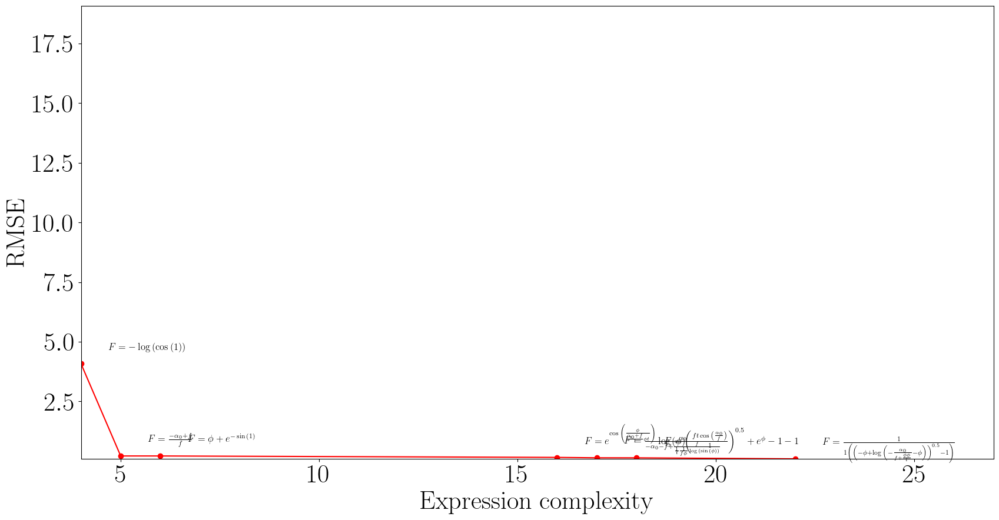

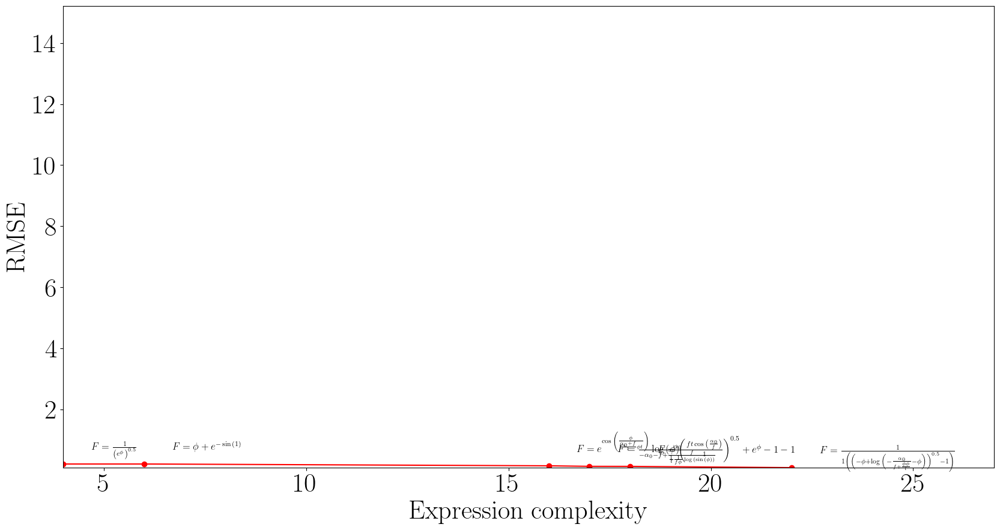

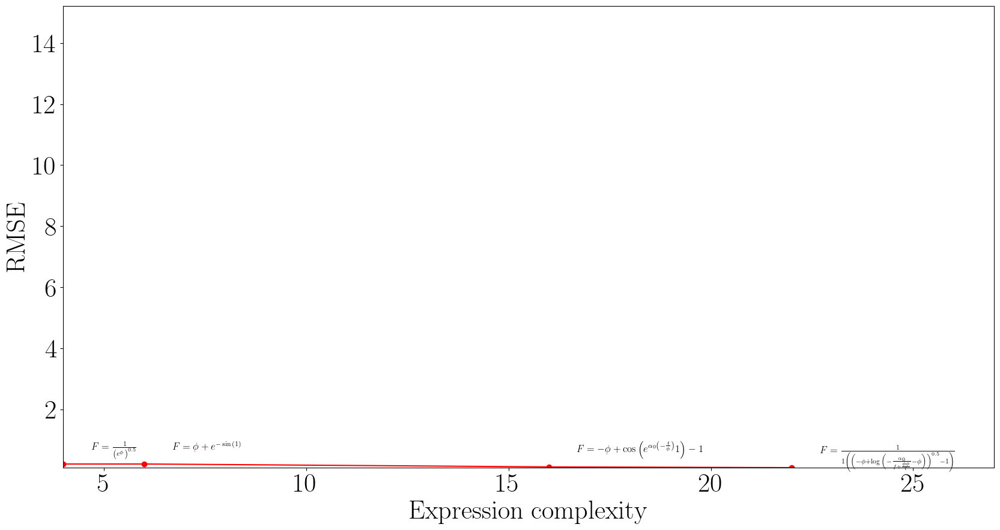

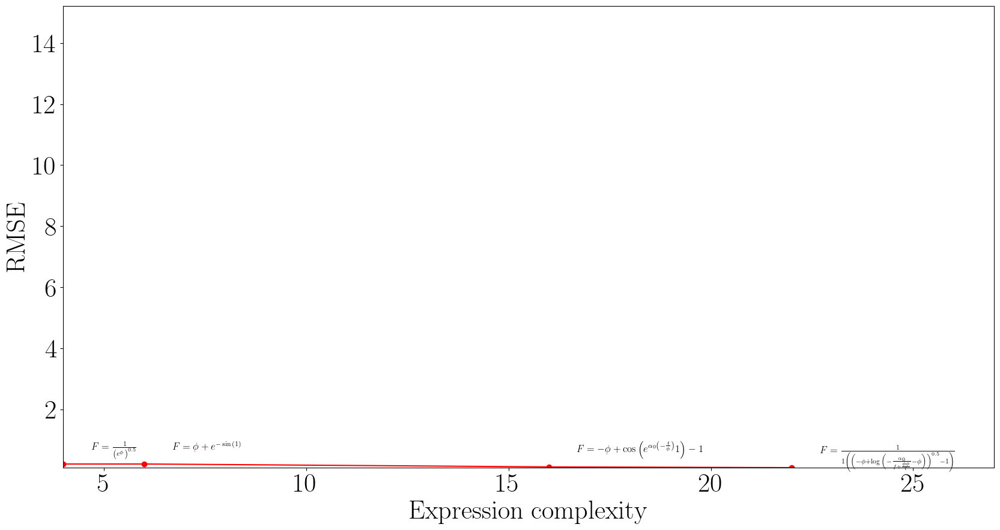

...

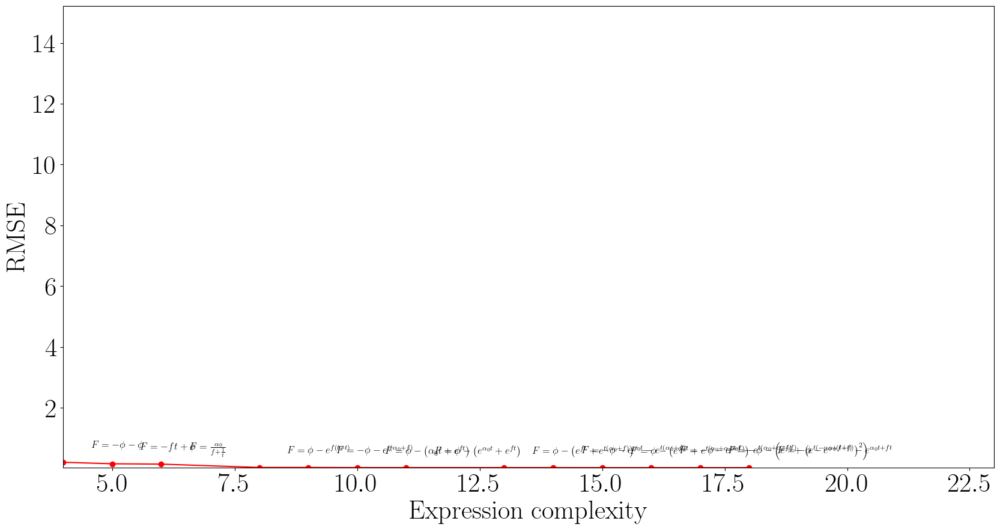

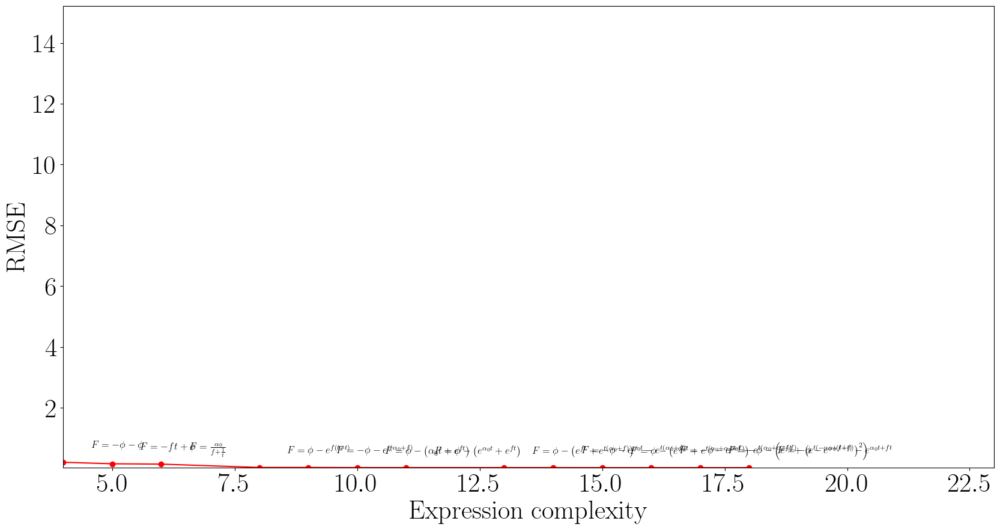

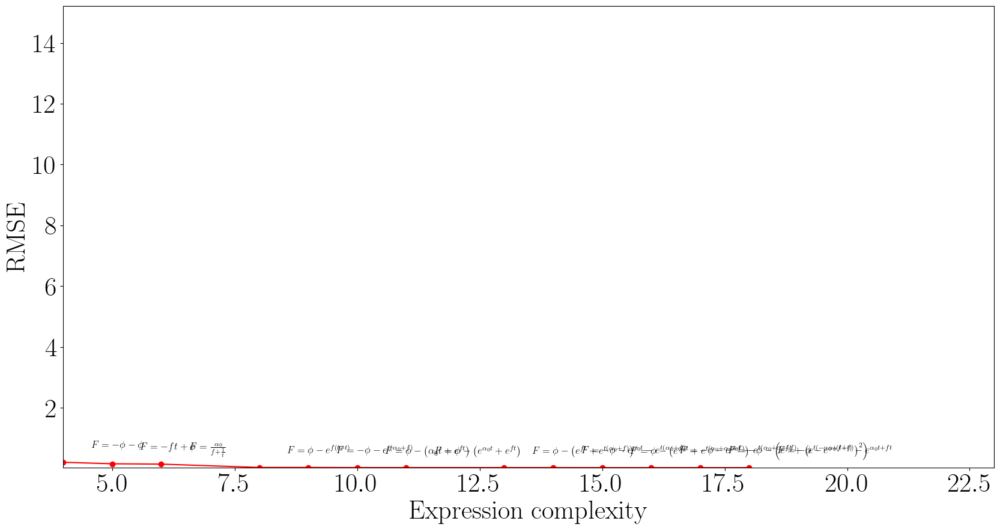

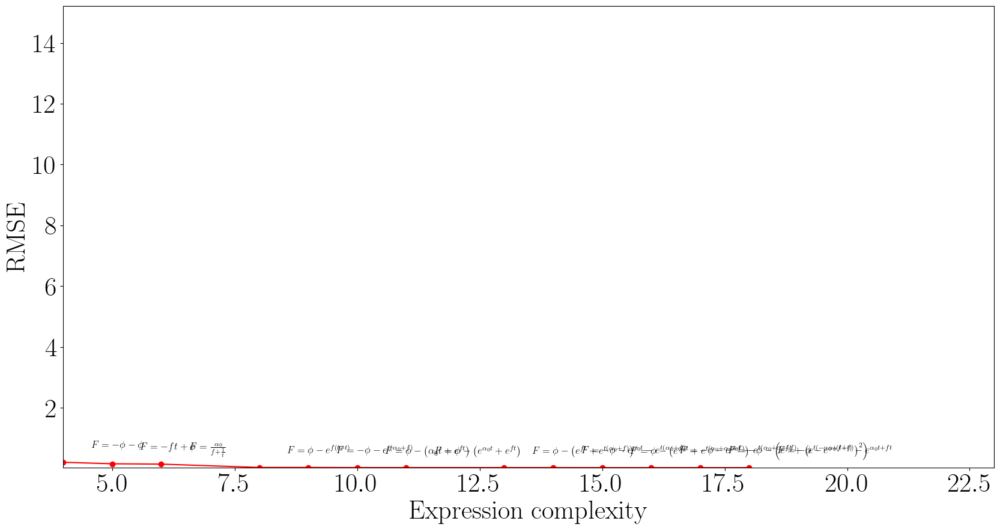

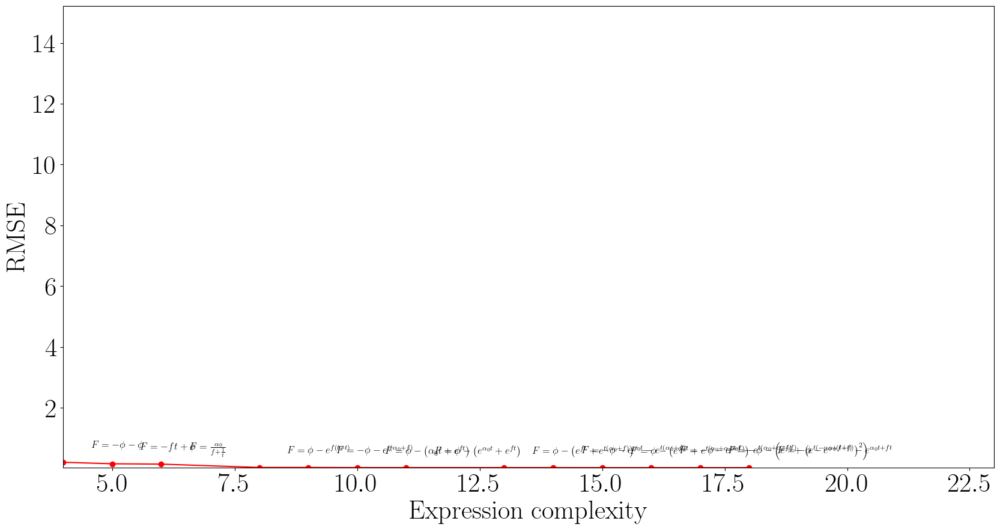

In [26]:
rewards, candidates = physo.fit (X, y, run_config,
                                stop_reward = 0.9999, 
                                stop_after_n_epochs = 5)

## Results

### Run plot

In [31]:
run_visualiser.make_visualisation()
run_visualiser.save_visualisation()
run_visualiser.save_data()

ValueError: x and y must have same first dimension, but have shapes (1005,) and (1000,)

### Pareto Front

In [27]:
def plot_pareto_front(run_logger,
                      do_simplify                   = True,
                      show_superparent_at_beginning = True,
                      eq_text_size                  = 12,
                      delta_xlim                    = [0, 5 ],
                      delta_ylim                    = [0, 0.3],
                      frac_delta_equ                = [0.03, 0.03],
                      figsize                       = (20, 10),
                     ):

    pareto_front_complexities, pareto_front_programs, pareto_front_r, pareto_front_rmse = run_logger.get_pareto_front()

    pareto_front_rmse = pareto_front_rmse
    # Fig params
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')
    # enables new_dummy_symbol = "\square"
    plt.rc('text.latex', preamble=r'\usepackage{amssymb} \usepackage{xcolor}')
    plt.rc('font', size=32)

    # Fig
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    ax.plot(pareto_front_complexities, pareto_front_rmse, 'r-')
    ax.plot(pareto_front_complexities, pareto_front_rmse, 'ro')

    # Limits
    xmin = pareto_front_complexities.min() + delta_xlim[0]
    xmax = pareto_front_complexities.max() + delta_xlim[1]
    ymin = pareto_front_rmse.min() + delta_ylim[0]
    ymax = pareto_front_rmse.max() + delta_ylim[1]
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    # Axes labels
    ax.set_xlabel("Expression complexity")
    ax.set_ylabel("RMSE")


    for i_prog in range (len(pareto_front_programs)):
        prog = pareto_front_programs[i_prog]

        text_pos  = [pareto_front_complexities[i_prog] + frac_delta_equ[0]*(xmax-xmin), 
                     pareto_front_rmse[i_prog]         + frac_delta_equ[1]*(ymax-ymin)]
        # Getting latex expr
        latex_str = prog.get_infix_latex(do_simplify = do_simplify)
        # Adding "superparent =" before program to make it pretty
        if show_superparent_at_beginning:
            latex_str = prog.library.superparent.name + ' =' + latex_str


        ax.text(text_pos[0], text_pos[1], f'${latex_str}$', size = eq_text_size)

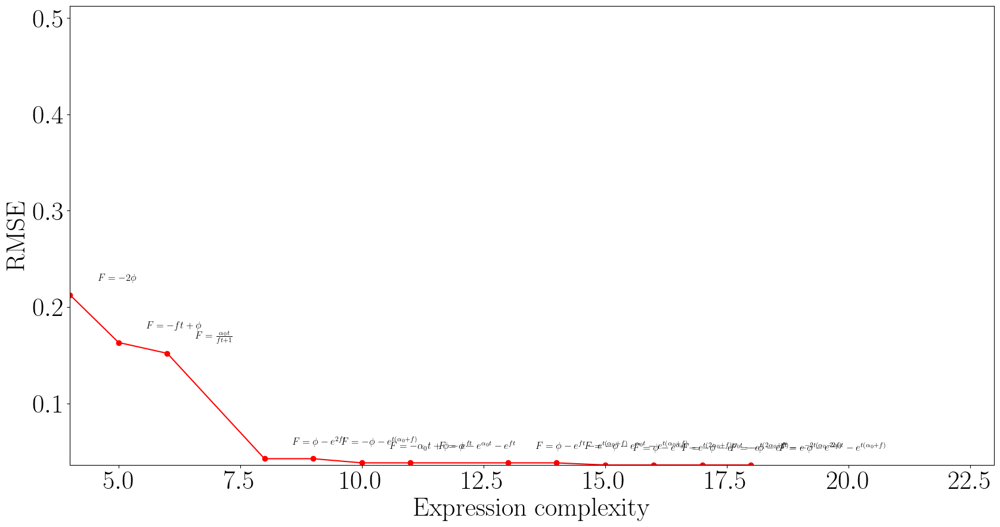

In [28]:
plot_pareto_front(run_logger)

### Complexity - accuracy optimums

In [29]:
pareto_front_complexities, pareto_front_programs, pareto_front_r, pareto_front_rmse = run_logger.get_pareto_front()

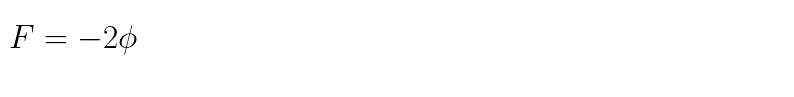

params = [ 0.1         1.         -2.34536252]


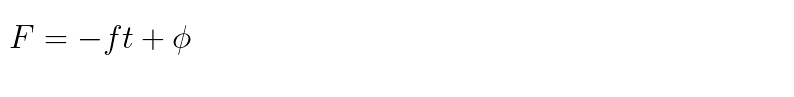

params = [ 0.1        -0.47631932  4.45561165]


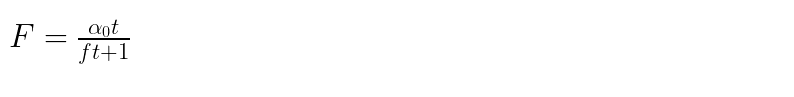

params = [1.32666573e+03 2.78048640e+02 1.00000000e+00]


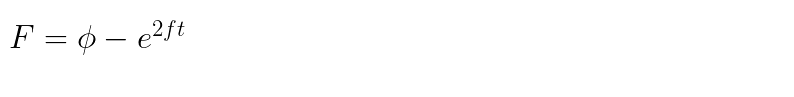

params = [ 0.1        -6.40321066  4.77473774]


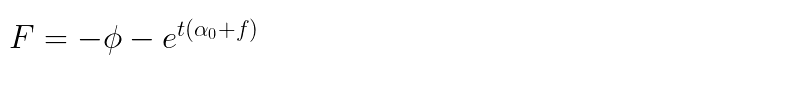

params = [-6.85340665 -5.95340665 -4.77473523]


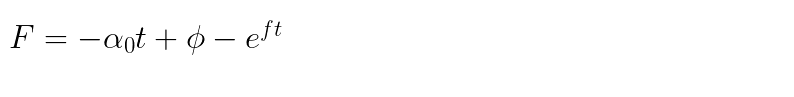

params = [ -0.09420906 -15.10186322   4.71643127]


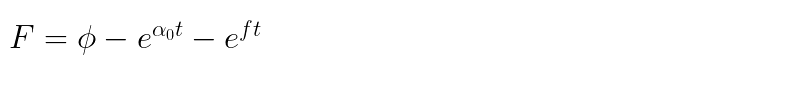

params = [-15.14468427  -0.09986075   5.71504835]


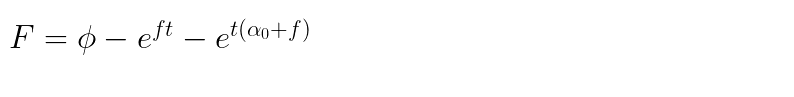

params = [-15.04400756  -0.09984028   5.71506003]


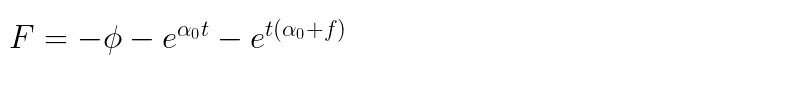

params = [ -0.09984507 -15.04401795  -5.71505732]


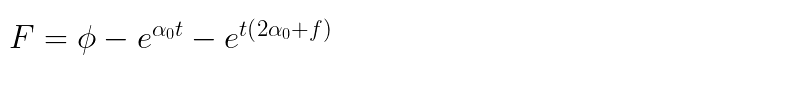

params = [-1.26495299e+01 -1.06775031e+04  4.77802617e+00]


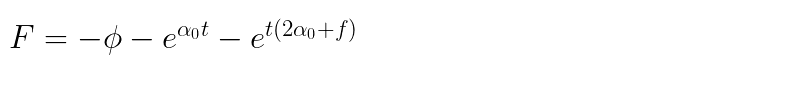

params = [-1.26498447e+01 -1.06773542e+04 -4.77802500e+00]


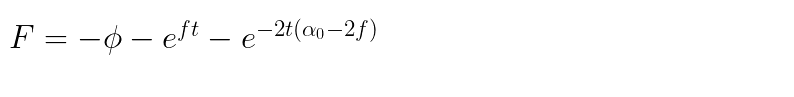

params = [ 5.32571944e+03 -1.26498873e+01 -4.77802604e+00]


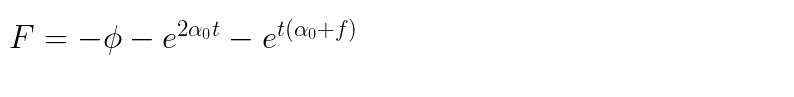

params = [-5.35004220e+03  5.33739243e+03 -4.77802569e+00]


In [30]:
for prog in pareto_front_programs:
    prog.show_infix(do_simplify=True)
    print("params =", prog.free_const_values.cpu().detach().numpy())